# Feature Representation

### Data Mining Project 2024/25

Authors: Nicola Emmolo, Simone Marzeddu, Jacopo Raffi

In [45]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [46]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap.umap_ as umap
from sklearn.metrics import mean_squared_error, mean_absolute_error

This function `show_plots()` show the plots of the attributes considering the pair of components, and it's used from both PCA and UMAP.

In [47]:
def show_plots(features, original_and_transformed_dataframe, x, y, grid_shape_x, grid_shape_y, figsize=(20, 10), label_fontsize=20, colorbar_fontsize=20):
    """
        Show plots for the selected features

        Parameters:
        - features: list of features to display
        - original_and_transformed_dataframe: dataframe with the original and transformed features
        - x: feature to display on the x axis
        - y: feature to display on the y axis
        - grid_shape_x: number of rows of the subplots
        - grid_shape_y: number of columns of the subplots
        - figsize: size of the figure
        - label_fontsize: font size for the axis labels
        - colorbar_fontsize: font size for the colorbar
    """

    fig, axes = plt.subplots(grid_shape_x, grid_shape_y, figsize=figsize) # Create a grid of subplots
    axes = axes.ravel() # Flatten the axes

    for i, feature in enumerate(features):
        ax = axes[i] # Select the i-th axis

        # Create a scatter plot on x and y
        scatter = ax.scatter(
            original_and_transformed_dataframe[x],
            original_and_transformed_dataframe[y],
            c=original_and_transformed_dataframe[feature],  #Color based on the feature
            cmap='viridis',  # Colormap
            s=10,  # Point size
            edgecolor='none'  # No edge color
        )

        # Set axis labels font size
        ax.set_xlabel(x, fontsize=label_fontsize)
        ax.set_ylabel(y, fontsize=label_fontsize)

        # Add colorbar
        cbar = fig.colorbar(scatter, ax=ax, label=feature)
        cbar.ax.tick_params(labelsize=colorbar_fontsize)  # Set the colorbar font size
        cbar.set_label(feature, fontsize=label_fontsize)  # Set the colorbar label font size

    # Remove the last subplot if the number of features is odd
    if len(features) % 2 != 0:
        fig.delaxes(axes[-1])

    plt.tight_layout() # Adjust the layout to avoid overlapping
    plt.show() # Show the plots

This function `mae_for_umap_components` is use for UMAP, specifically to understand the number of components to use considering the Mean Absolute Error.

In [48]:
def mae_for_umap_components(data_scaled, components_range):
    """
        Compute the reconstruction error for different numbers of UMAP components

        Parameters:
        - data_scaled: scaled data
        - components_range: range of components to test
    """

    reconstruction_errors = []

    for components in components_range:
        umap_reducer = umap.UMAP(n_components=components)
        umap_embeddings = umap_reducer.fit_transform(data_scaled) # Fit and transform the data
        print("\nstarting - ", components)
        reconstructed_data = umap_reducer.inverse_transform(umap_embeddings) # Inverse transform the data
        print("inverse done - ", components)
        mae = mean_absolute_error(data_scaled, reconstructed_data) # Compute the mean absolute error
        print("mae done - ", mae)
        reconstruction_errors.append(mae)

    # Plot the reconstruction errors
    plt.plot(components_range, reconstruction_errors, marker='o')
    plt.xlabel('Number of Components')
    plt.ylabel('Reconstruction Error (MAE)')
    plt.title('UMAP Reconstruction Error vs Components')
    plt.show()

## Ronde van Vlaanderen

In [49]:
ronde_dataset = pd.read_csv('../../data/complete_dataset_no_outliers.csv').drop(columns=['profile', 'uci_points', 'mean_cyclist_cp', 'mean_delta', 'mean_position', 'raw_position', 'points'])
ronde_dataset = ronde_dataset[ronde_dataset['race_name'] == 'Ronde van Vlaanderen']
ronde_dataset = ronde_dataset.select_dtypes(include=['number'])
ronde_dataset = ronde_dataset.dropna().reset_index(drop=True)

ronde_dataset.info()

scaler = StandardScaler()
ronde_dataset_scaled = scaler.fit_transform(ronde_dataset)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 762 entries, 0 to 761
Data columns (total 20 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   birth_year                   762 non-null    int64  
 1   weight                       762 non-null    float64
 2   height                       762 non-null    float64
 3   length                       762 non-null    float64
 4   climb_total                  762 non-null    float64
 5   startlist_quality            762 non-null    int64  
 6   position                     762 non-null    float64
 7   cyclist_age                  762 non-null    int64  
 8   delta                        762 non-null    float64
 9   race_year                    762 non-null    int64  
 10  cyclist_bmi                  762 non-null    float64
 11  climb_percentage             762 non-null    float64
 12  cyclist_climb_power          762 non-null    float64
 13  race_physical_effort

### PCA

In [13]:
# PCA
pca_instance = PCA()
pca_transformation = pca_instance.fit_transform(ronde_dataset_scaled)

In [14]:
# variance per component
eigenvalues = pca_instance.explained_variance_
# variance per component, scaled to sum to 1
scaled_eigenvalues = pca_instance.explained_variance_ratio_
# eigenvectors, i.e., axes of reference
eigenvectors = pca_instance.components_


# norm of the whole transformation
transformation_norm_per_column = (pca_transformation ** 2).sum(axis=0)
cumulative_norm_per_reduction = np.cumsum(transformation_norm_per_column)

pca_dataframe = pd.DataFrame.from_records(
    zip(
        eigenvalues,
        scaled_eigenvalues,
        cumulative_norm_per_reduction
    ),
    columns=["eigenvalues", "scaled_eigenvalues", "transformation_norm"]
)
pca_dataframe

,eigenvalues,scaled_eigenvalues,transformation_norm
0,3.924055,0.195945,2986.206118
1,3.085709,0.154083,5334.430497
2,2.183247,0.109019,6995.881616
3,1.806972,0.090230,8370.987479
4,1.700647,0.084921,9665.179708
5,1.370503,0.068435,10708.132733
6,1.198529,0.059848,11620.213208
7,1.139040,0.056877,12487.023005
8,0.885562,0.044220,13160.935703
9,0.751130,0.037507,13732.545698


<Axes: xlabel='None', ylabel='scaled_eigenvalues'>

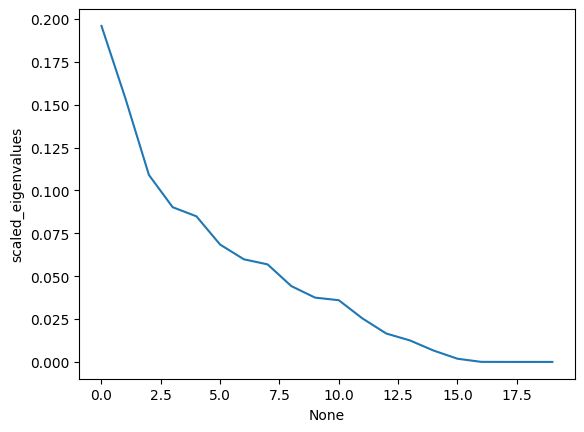

In [15]:
sb.lineplot(
    pca_dataframe,
    y="scaled_eigenvalues",
    x=pca_dataframe.index
)

In [16]:
pca_dataframe = pd.DataFrame(pca_transformation[:, :6], columns=["pca_1", "pca_2", "pca_3", "pca_4", "pca_5", "pca_6"])
original_and_transformed_dataframe = pd.concat(
    [
        ronde_dataset,
        pca_dataframe
    ],
    axis="columns"
)

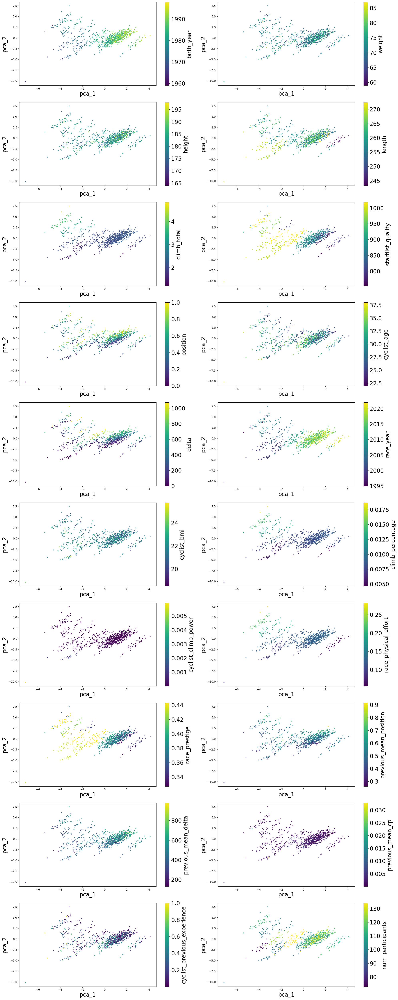

In [17]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_2", 10, 2, figsize=(20,50))

- weight
- height
- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- previous_mean_position
- previous_mean_delta
- cyclist_previous_experience
- num_participants

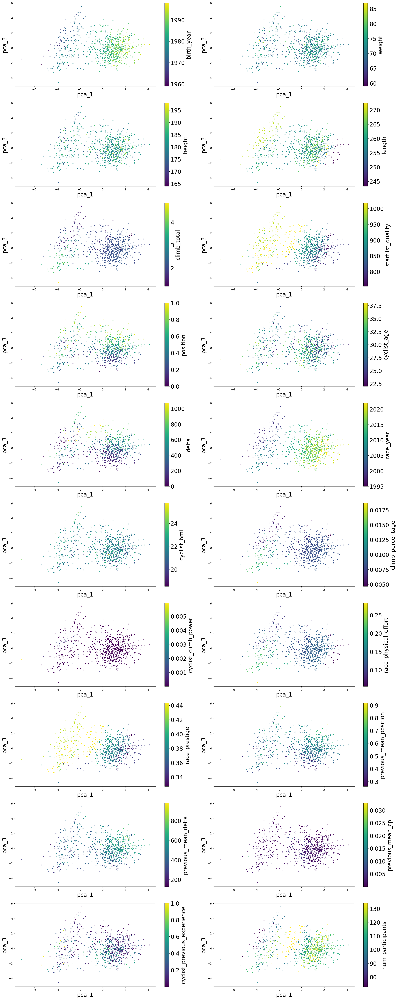

In [18]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_3", 10, 2, figsize=(20,50))

- weight
- height
- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- previous_mean_position
- previous_mean_delta
- cyclist_previous_experience
- num_participants

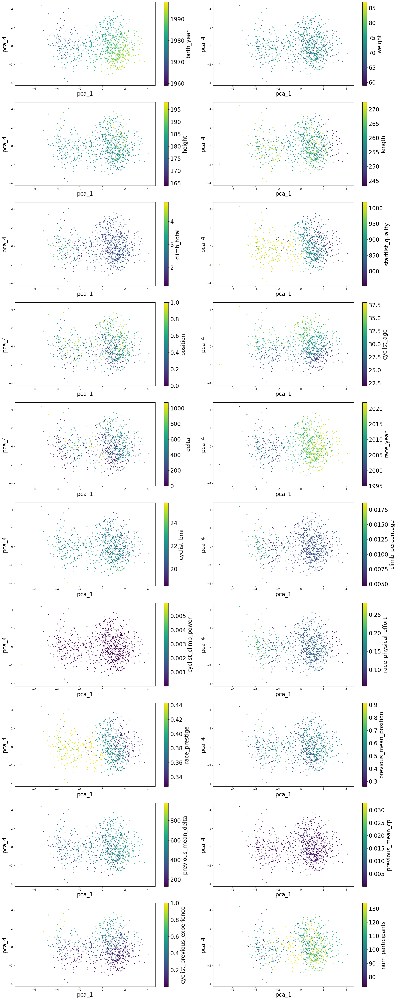

In [19]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_4", 10, 2, figsize=(20,50))

- weight
- height
- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- previous_mean_position
- previous_mean_delta
- cyclist_previous_experience
- num_participants

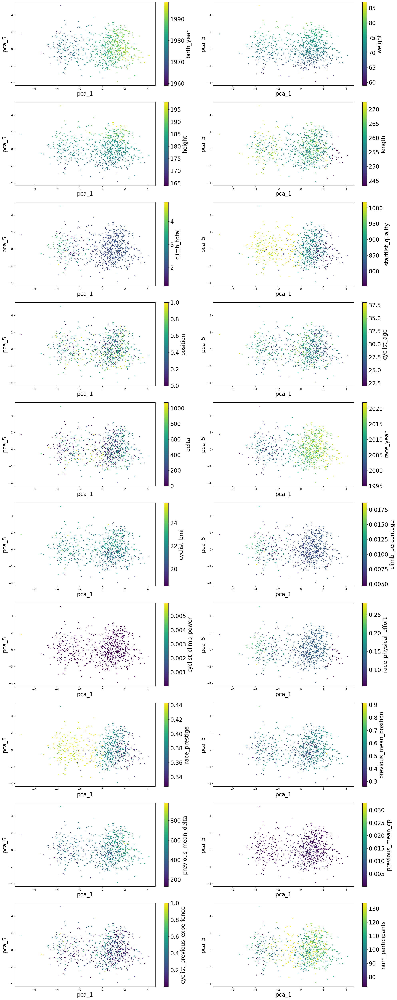

In [20]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_5", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- previous_mean_position
- previous_mean_delta
- cyclist_previous_experience
- num_participants

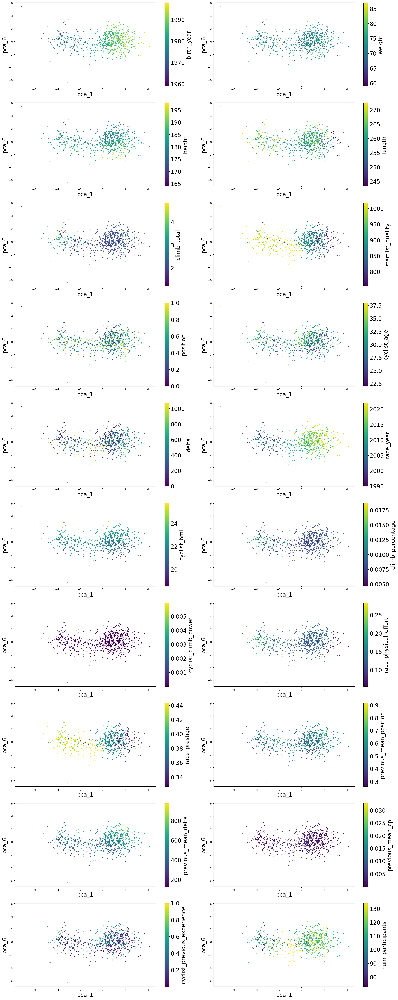

In [21]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_1", "pca_6", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- previous_mean_position
- cyclist_previous_experience
- num_participants

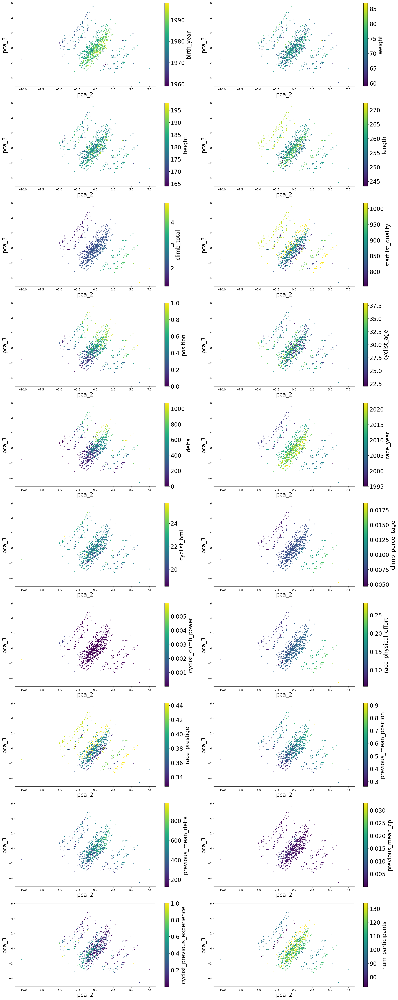

In [22]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_2", "pca_3", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- cyclist_previous_experience
- num_participants

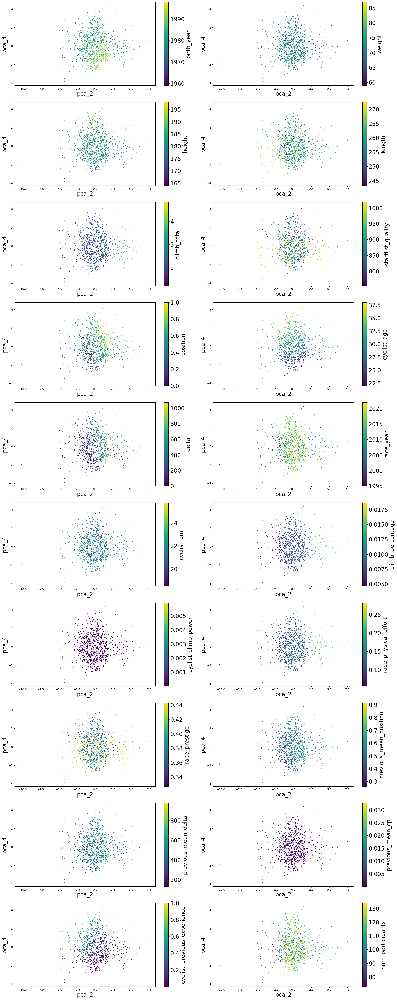

In [23]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_2", "pca_4", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- num_participants

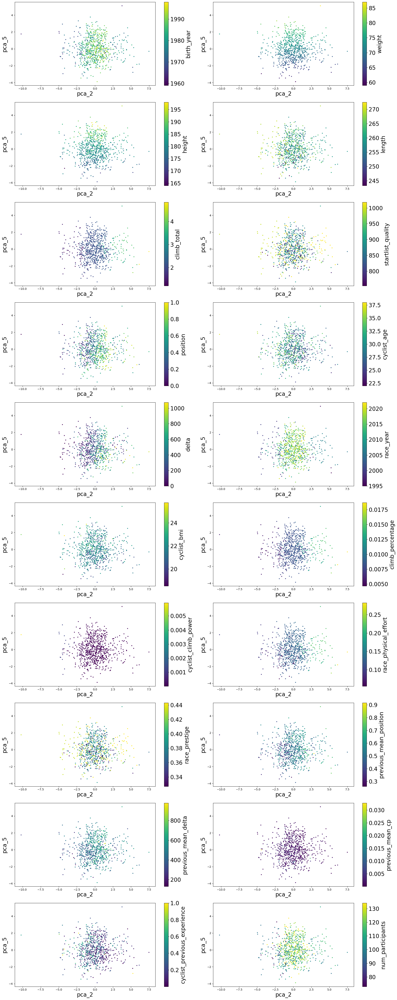

In [24]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_2", "pca_5", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- num_participants

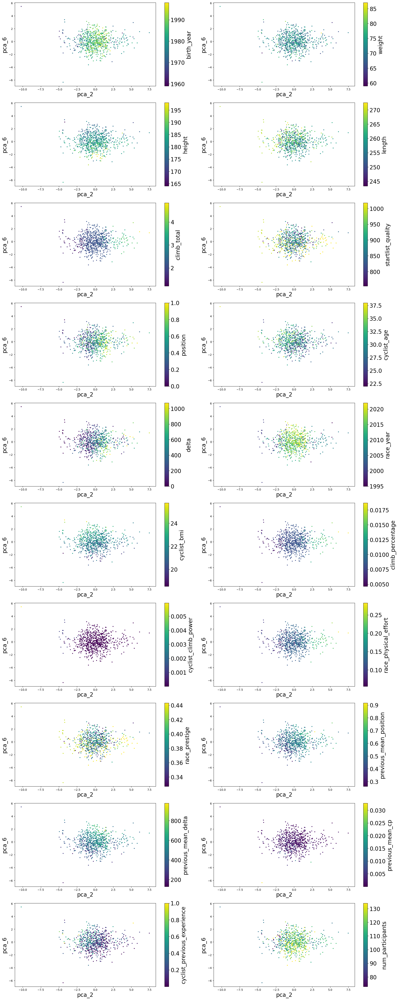

In [25]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_2", "pca_6", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- cyclist_age
- delta
- race_year
- cyclist_bmi
- race_prestige
- num_participants

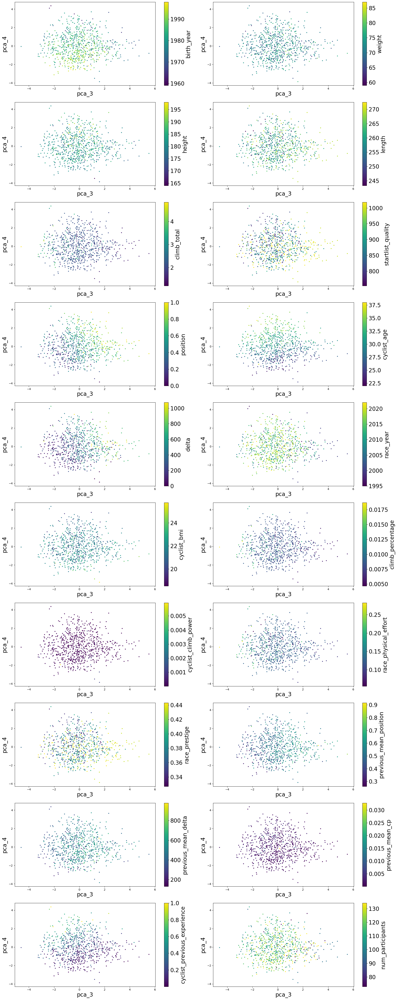

In [26]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_3", "pca_4", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- delta
- race_year
- cyclist_bmi
- race_prestige
- num_participants

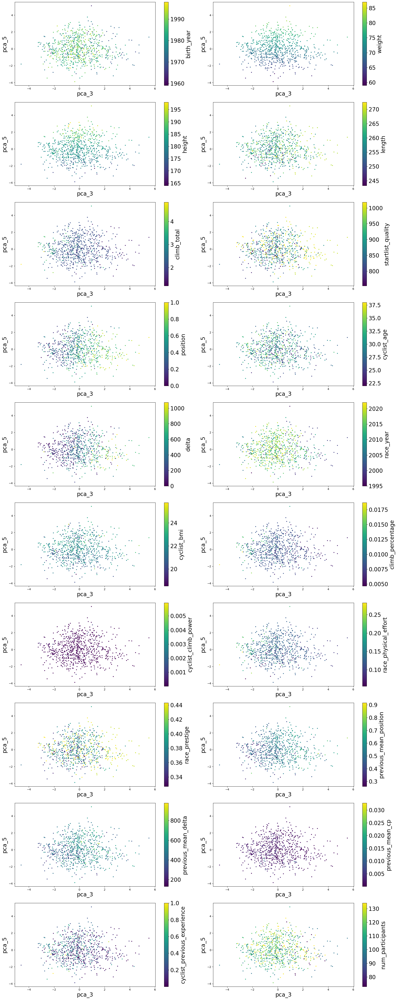

In [27]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_3", "pca_5", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- delta
- race_year
- cyclist_bmi
- race_prestige
- num_participants

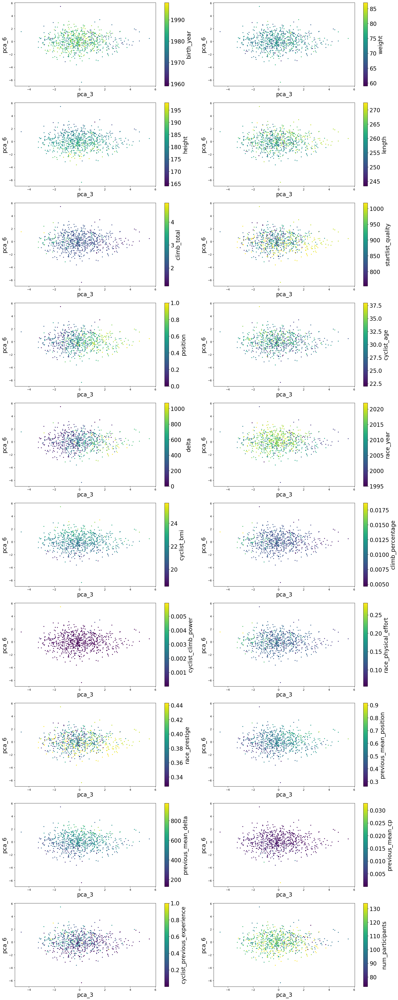

In [28]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_3", "pca_6", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- delta
- race_year
- cyclist_bmi
- race_prestige
- num_participants

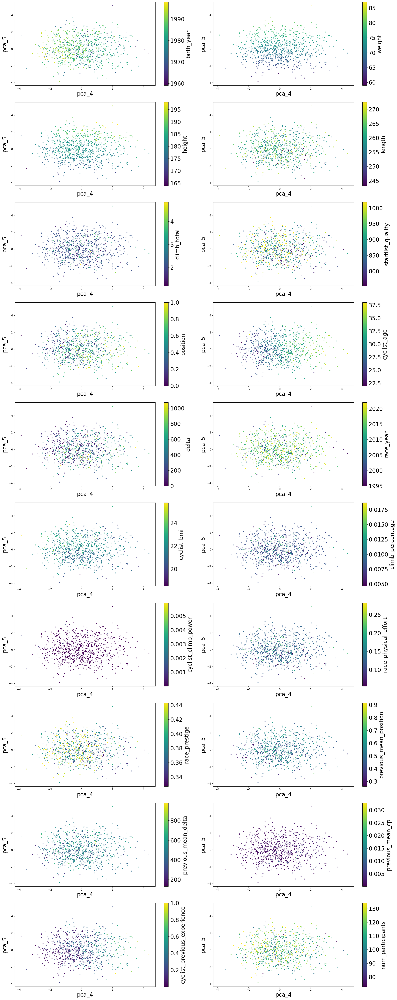

In [29]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_4", "pca_5", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- delta
- race_year
- cyclist_bmi
- race_prestige
- num_participants

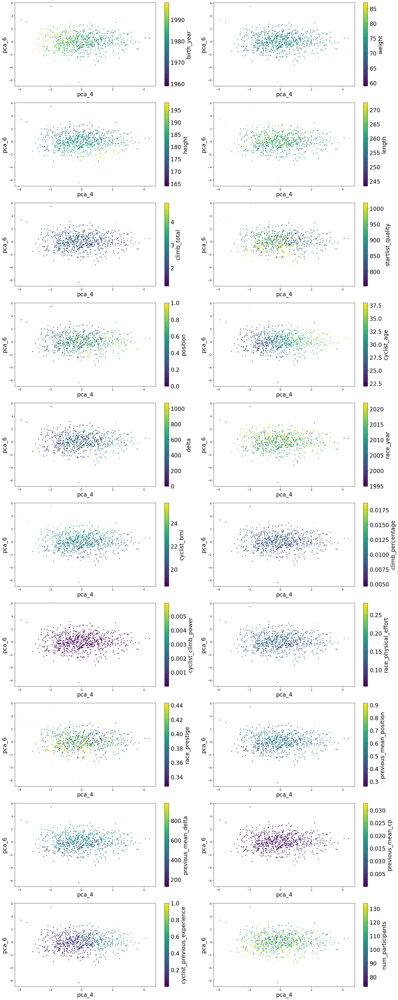

In [30]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_4", "pca_6", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- delta
- race_year
- race_prestige
- num_participants

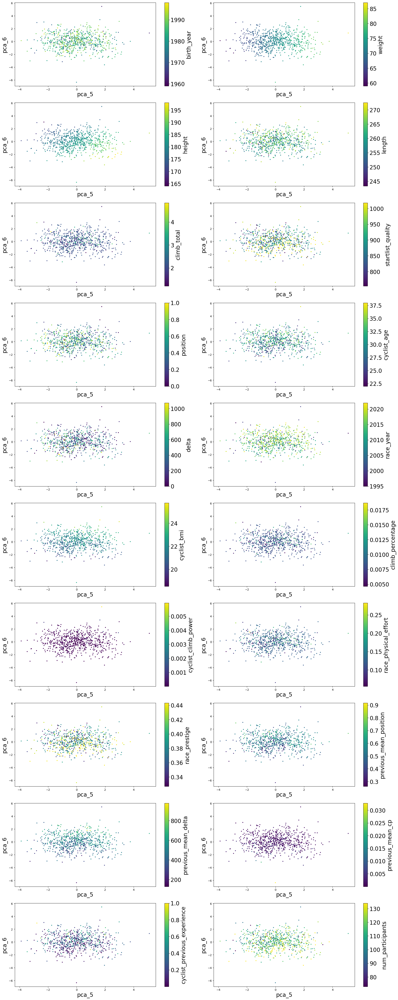

In [31]:
show_plots(ronde_dataset.columns, original_and_transformed_dataframe, "pca_5", "pca_6", 10, 2, figsize=(20,50))

- length
- startlist_quality
- position
- delta
- race_year
- race_prestige
- num_participants

Considering all the possible alignments of the features with the principal components found by PCA, we can notice how the features `length`, `startlist_quality`, `position`, `delta`, `race_year`, `race_prestige` and `num_participants` present a poor alignment in general.

### UMAP

To select the number of components in UMAP, we consider how well the reduced data can reconstruct the original data. We can try different configurations of `n_components` and compare the quality of the reconstruction using the inverse parameter (`inverse_transform`).


starting -  2
inverse done -  2
mae done -  0.4007329474929871

starting -  3
inverse done -  3
mae done -  0.3876379559211414

starting -  4
inverse done -  4
mae done -  0.38338172700357337

starting -  5
inverse done -  5
mae done -  0.3822491796300854

starting -  6
inverse done -  6
mae done -  0.3828320723937303


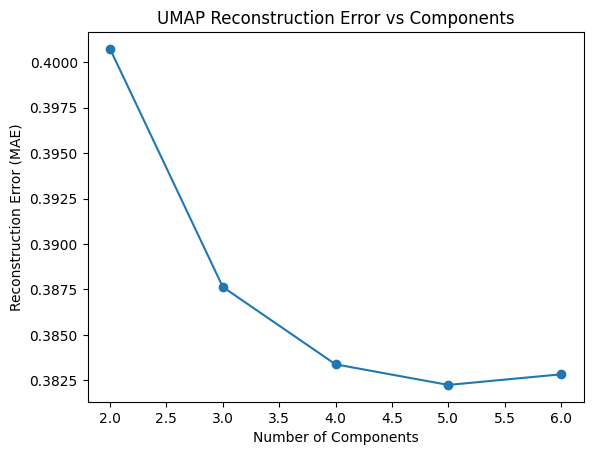

In [ ]:
mae_for_umap_components(ronde_dataset_scaled, range(2, 7))

In [32]:
# UMAP
umap_reducer = umap.UMAP(n_components=5, random_state=42)
umap_embeddings = umap_reducer.fit_transform(ronde_dataset_scaled)

/Users/nicolaemmolo/dm_env/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


In [33]:
umap_embeddings

array([[ 9.425382  , -0.978137  , 10.160452  ,  2.099765  ,  7.600937  ],
       [-3.2711108 ,  6.757063  ,  7.066509  ,  0.94493145,  7.3018556 ],
       [10.418367  , 11.856505  , 11.849948  , -0.8243425 ,  9.55657   ],
       ...,
       [ 9.926003  , 12.60318   , 11.193127  ,  0.52202654,  9.218594  ],
       [ 9.236647  , 12.331386  ,  8.833826  ,  5.720204  , 11.465648  ],
       [10.0594225 , 11.557965  , 10.999768  , -1.4612399 , 10.392653  ]],
      dtype=float32)

In [34]:
umap_dataframe = pd.DataFrame(umap_embeddings[:, :5], columns=["umap_1", "umap_2", "umap_3", "umap_4", "umap_5"])
umap_original_and_transformed_dataframe = pd.concat(
    [
        ronde_dataset,
        umap_dataframe
    ],
    axis="columns"
)

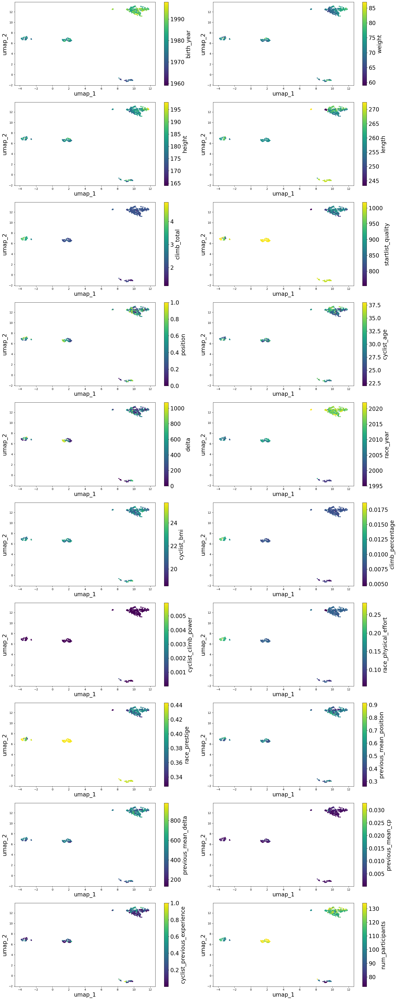

In [35]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_2", 10, 2, figsize=(20,50))

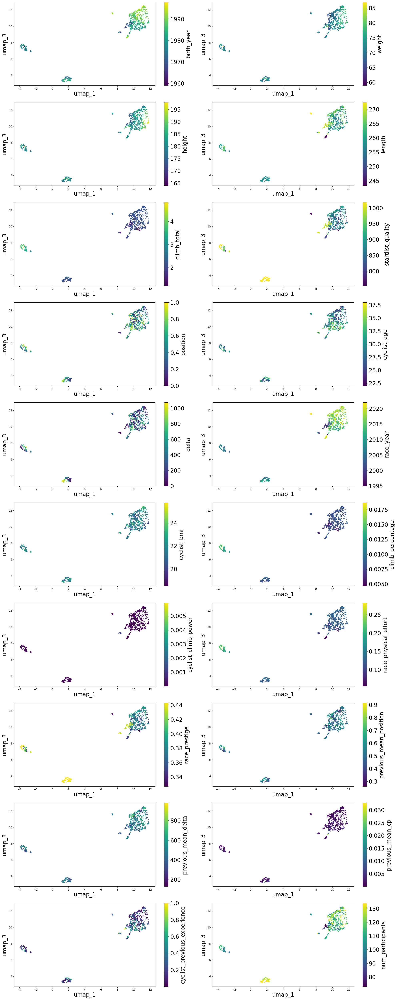

In [36]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_3", 10, 2, figsize=(20,50))

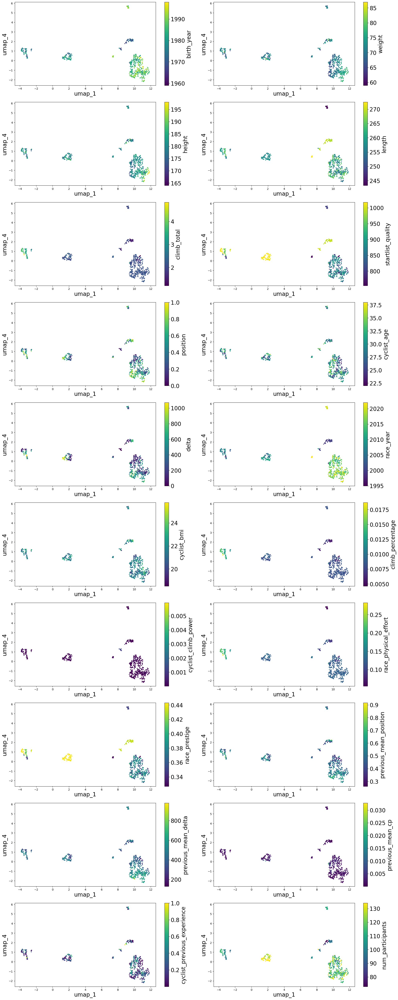

In [37]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_4", 10, 2, figsize=(20,50))

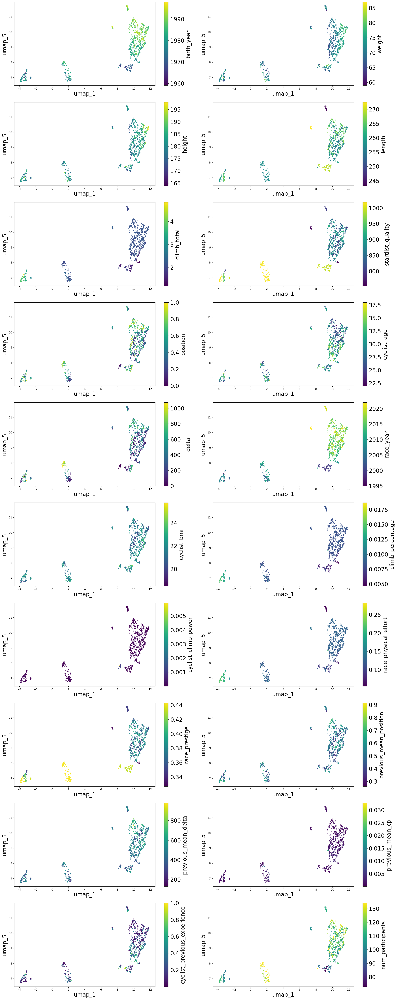

In [38]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_1", "umap_5", 10, 2, figsize=(20,50))

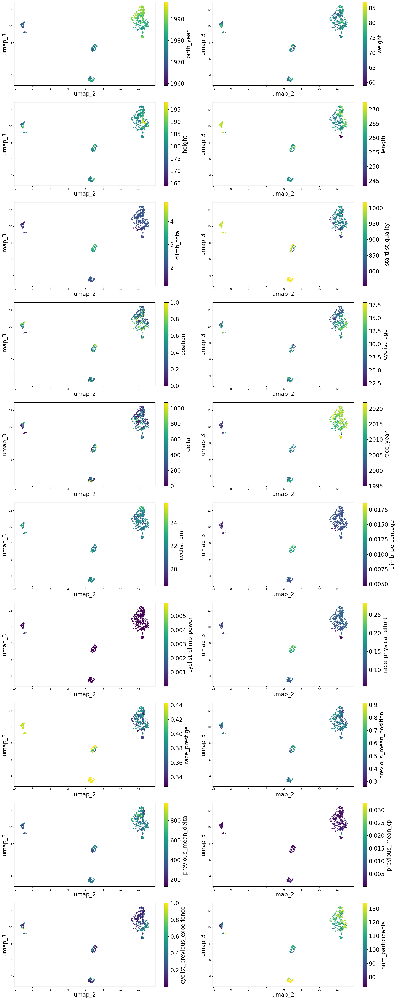

In [39]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_3", 10, 2, figsize=(20,50))

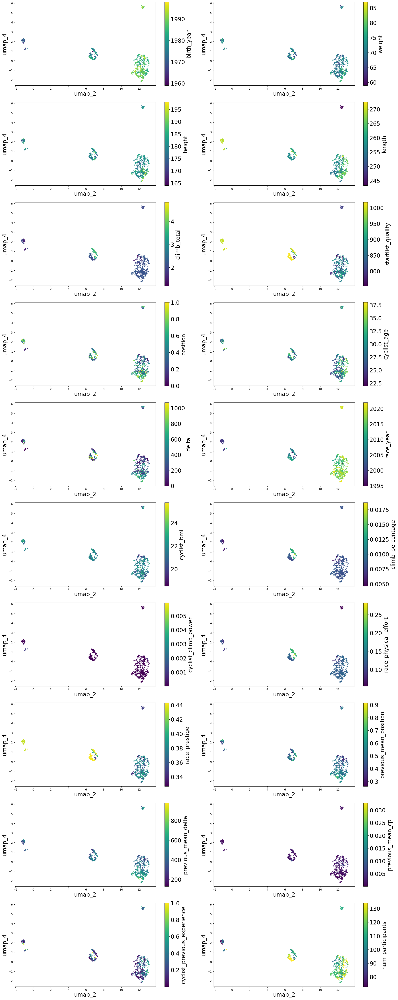

In [40]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_4", 10, 2, figsize=(20,50))

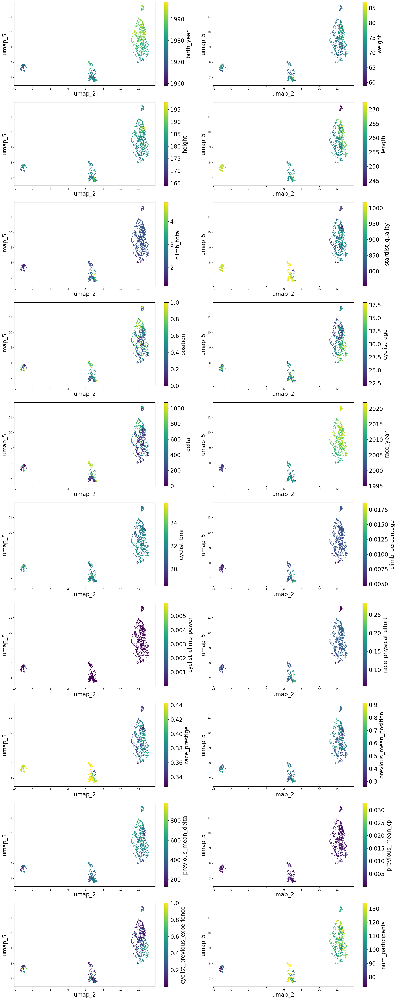

In [41]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_2", "umap_5", 10, 2, figsize=(20,50))

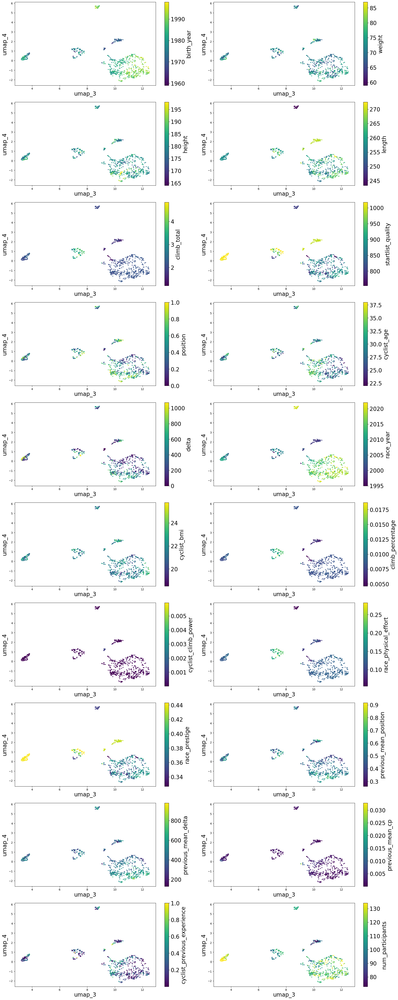

In [42]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_3", "umap_4", 10, 2, figsize=(20,50))

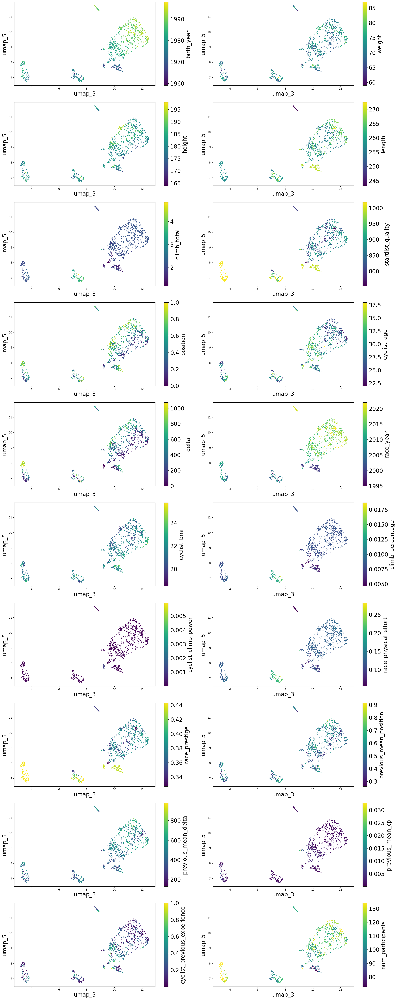

In [43]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_3", "umap_5", 10, 2, figsize=(20,50))

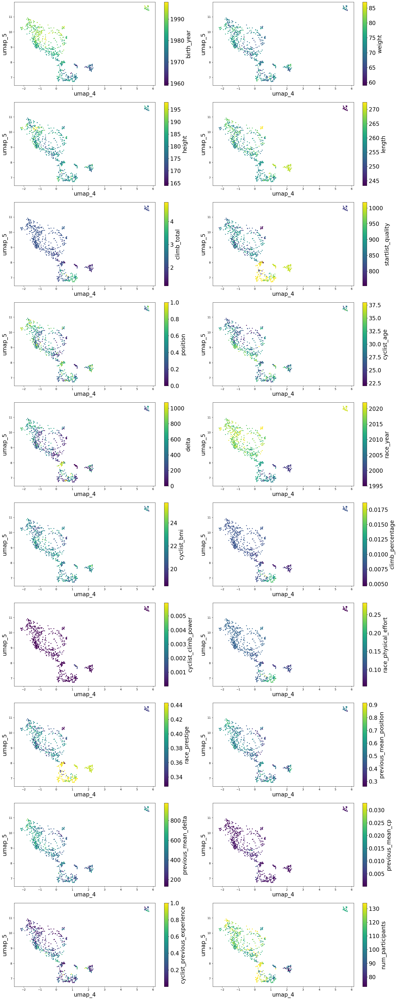

In [44]:
show_plots(ronde_dataset.columns, umap_original_and_transformed_dataframe, "umap_4", "umap_5", 10, 2, figsize=(20,50))

After the UMAP results, we can see that almost all the features demostrate weak correlation with the components in the several directions, and this is may due to the problem during our feature selection for the numer of components, that lead us to a possibly wrong selection.

Otherwise, we still perform the PCA analisis, and so we mostly consider those results, and for clustering activities with the "ronde" data we decide to not use the `length`, `startlist_quality`, `position`, `delta`, `race_year`, `race_prestige` and `num_participants` attributes.